In [114]:
from sklearn.cluster import KMeans
from sklearn.metrics import normalized_mutual_info_score
from itertools import combinations
import pandas as pd
import os
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np
from scipy.spatial.distance import cdist
import networkx as nx
from sklearn.metrics import silhouette_score
import seaborn as sns

In [115]:
filelocation_TET = 'NDT_all_12thDec_uncleaned.csv'
feelings = ['MetaAwareness','Presence','PhysicalEffort','MentalEffort','Boredom', 'Receptivity', 'EmotionalIntensity', 'Clarity', 'Release', 'Bliss', 'Embodiment', 'Insightfulness', 'Anxiety', 'SpiritualExperience']
header = "Week"
no_dimensions = 2
colours = {0:'red',1:'green',2:'blue',3:'orange',4:'pink',5:'yellow'}
colours_list = ['red','green','blue','orange','pink','yellow']
n_clust = 3
headers = {'Subject':0, 'Week':1, 'Session':2}
lcm = 332640
n_rep = 1
no_of_jumps = 7

In [116]:
class csv_splitter:

    def __init__(self,excel_file_name):
        self.excel_file_location = f'c:\\Users\\hugma\\diss\\{excel_file_name}'
        self.dataframes = None
    def read_excel(self):
        try:
            df_excel_file_name = pd.read_csv(self.excel_file_location)
            return df_excel_file_name
        except Exception as e:
            print(f"error reading Excel file: {e}")
    def split_by_header(self,df_excel_file_name, heading):
        if heading not in df_excel_file_name.columns:
            print(f"Error: '{heading}' not found in DataFrame columns.")
            return None
        heading_values = df_excel_file_name[heading].unique()
        split_df = {value: df_excel_file_name[df_excel_file_name[heading] == value] for value in heading_values}
        split_df_array = [[key, value] for key, value in split_df.items()]
        return split_df, split_df_array

In [117]:
class principal_component_finder:

    def __init__(self,csv_file, feelings,no_dimensions):
        self.csv_file_TET = csv_file[feelings]
        corr_matrix = self.csv_file_TET.corr()
        pca = PCA(n_components=no_dimensions)
        self.principal_components=pca.fit_transform(corr_matrix)
        self.explained_variance_ratio = pca.explained_variance_ratio_
    def PCA_TOT(self):
        df_TET_feelings_prin = self.csv_file_TET.dot(self.principal_components)
        for i in range(0,self.principal_components.shape[1]):
            y_values = []
            for j in range(0,len(feelings)):
                y_values.append(self.principal_components[j][i])
            plt.figure()
            plt.bar(feelings,y_values)
            plt.title(f'principal componant {i+1}')
            plt.xticks(rotation=45, ha='right')
            plt.tight_layout()
            plt.savefig(f'C:/Users/hugma/diss/data/principal_componant{i+1}')
        plt.figure()
        plt.scatter(df_TET_feelings_prin[0],df_TET_feelings_prin[1], s=0.5)
        plt.xlabel('principal componant 1 (bored/effort)')
        plt.ylabel('principal componant 2 (calm)')
        plt.xlim(-6,6)
        plt.ylim(-1,2)
        
        return self.principal_components, self.explained_variance_ratio, df_TET_feelings_prin
    def PCA_split(self,split_df_array):
        split_df_array_TET = [[split_df_array[i][0],split_df_array[i][1][feelings]] for i in range(0,len(split_df_array))]
        split_csv_TET = {split_df_array_TET[i][0]: split_df_array_TET[i][1] for i in range(0,len(split_df_array))}
        df_TET_feelings_prin_dict = {name: split_csv_TET[name].dot(self.principal_components) for name in split_csv_TET.keys()}
        
        for key,value in df_TET_feelings_prin_dict.items():
            plt.figure()
            plt.scatter(value[0],value[1],s=0.5)
            plt.title(key)
            plt.xlabel('principal componant 1 (bored/effort)')
            plt.ylabel('principal componant 2 (calm)')
            plt.xlim(-6,6)
            plt.ylim(-1,2)
            plt.show()
        return df_TET_feelings_prin_dict

In [118]:
csv_splitter_instance = csv_splitter(filelocation_TET)
df_csv_file_original = csv_splitter_instance.read_excel()
split_df, split_csv_array = csv_splitter_instance.split_by_header(df_csv_file_original,header)

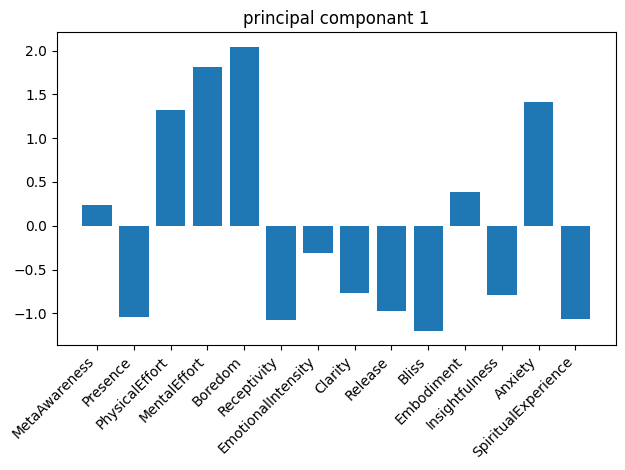

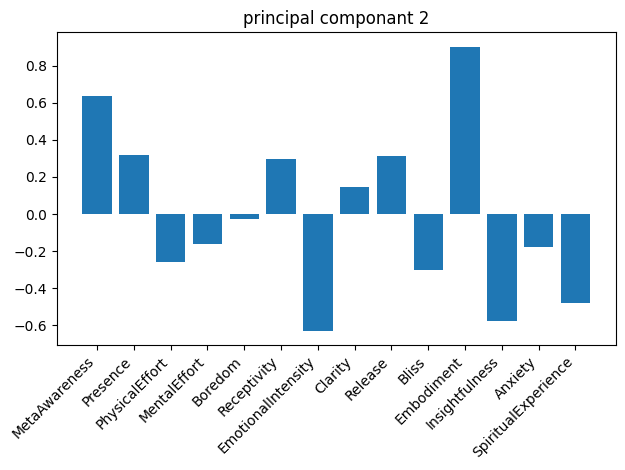

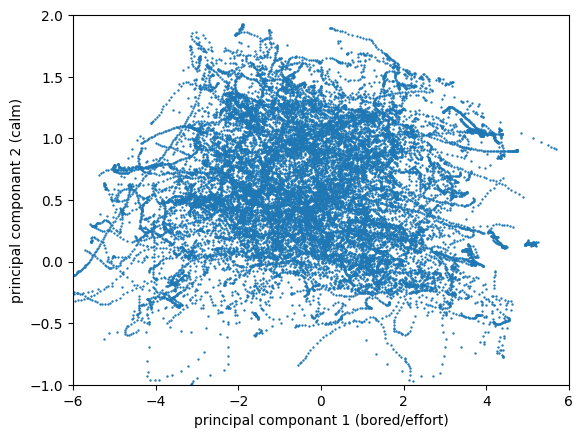

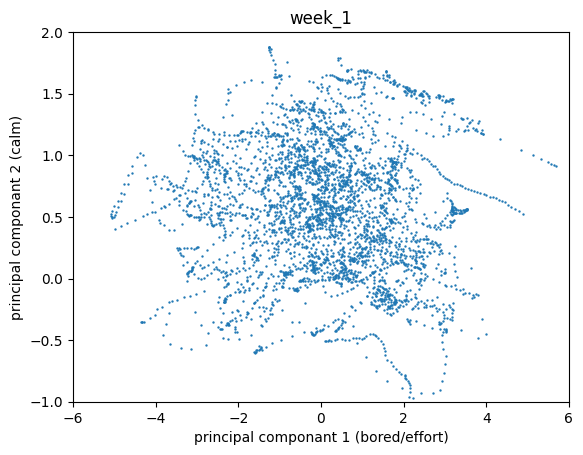

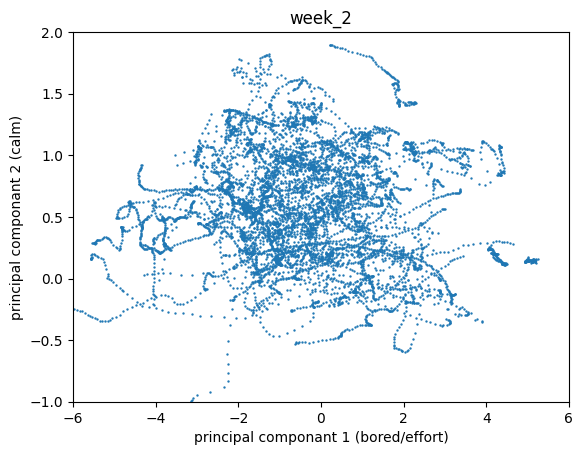

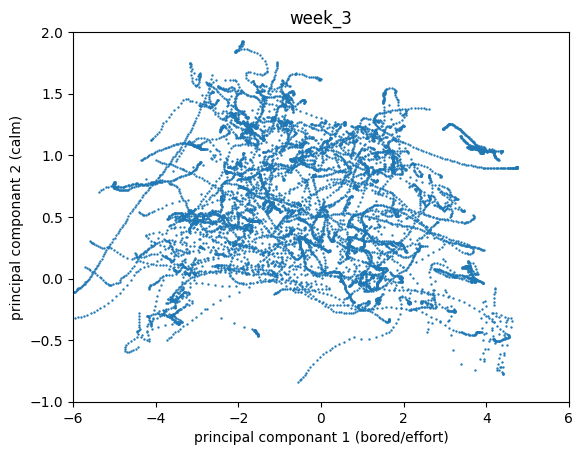

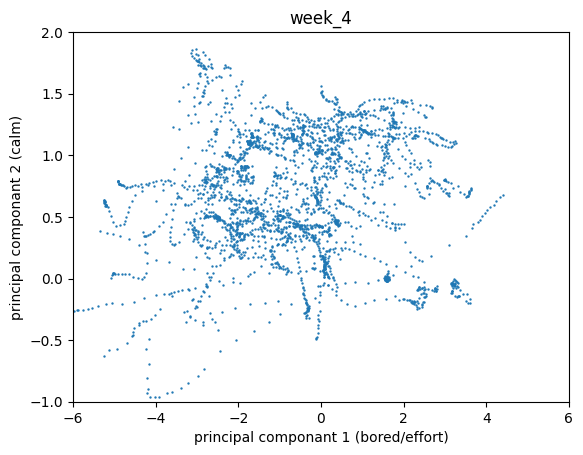

In [119]:
principal_component_finder_instance = principal_component_finder(df_csv_file_original,feelings,no_dimensions)
principal_components, explained_variance_ratio, df_TET_feelings_prin = principal_component_finder_instance.PCA_TOT()
df_TET_feelings_prin_dict = principal_component_finder_instance.PCA_split(split_csv_array)

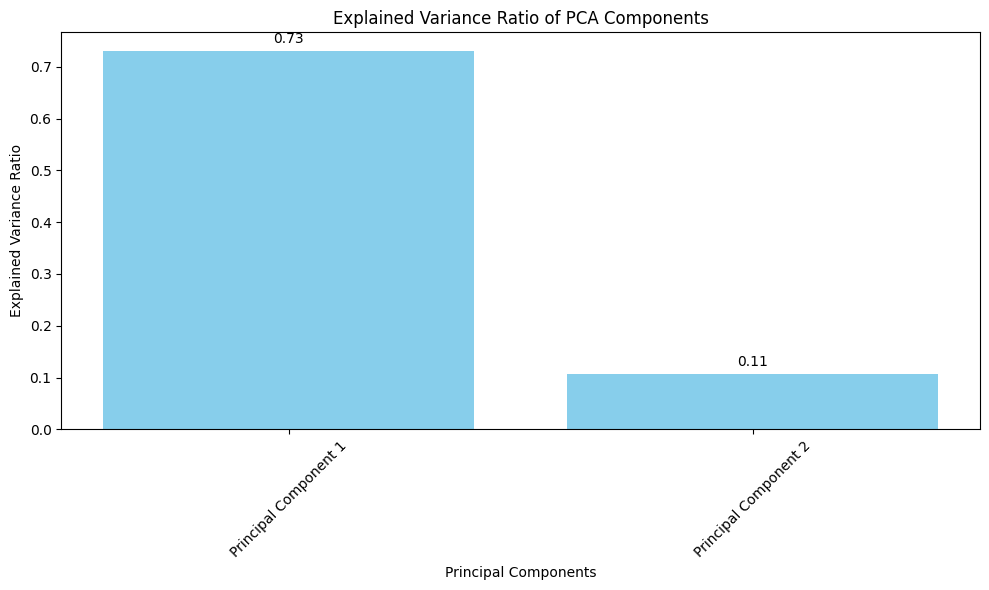

In [120]:
num_components = len(explained_variance_ratio)

# Creating labels for the principal components
labels = [f"Principal Component {i+1}" for i in range(num_components)]

# Creating the bar plot
plt.figure(figsize=(10, 6))
plt.bar(labels, explained_variance_ratio, color='skyblue')

# Adding title and labels
plt.title('Explained Variance Ratio of PCA Components')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance Ratio')

# Adding value labels on top of each bar
for i, v in enumerate(explained_variance_ratio):
    plt.text(i, v + 0.01, f"{v:.2f}", ha='center', va='bottom')

# Display the plot
plt.xticks(rotation=45)  # Rotates labels to prevent overlap
plt.tight_layout()  
plt.savefig('C:/Users/hugma/diss/data/PCA_variance')

In [121]:
split_dict_skip = {}
for (subject, week, session), group in df_csv_file_original.groupby(['Subject', 'Week', 'Session']):
    split_dict_skip[(subject, week, session)] = group.iloc[::no_of_jumps].copy()
df_csv_file = pd.concat([df for df in split_dict_skip.values()])

In [122]:
for feeling in feelings: 
 
    df_csv_file[f'{feeling}_diff'] = -df_csv_file[feeling].diff(-1)

In [123]:
split_dict = {}
for (subject, week, session), group in df_csv_file.groupby(['Subject', 'Week', 'Session']):
    split_dict[(subject, week, session)] = group.copy()

In [124]:
differences_array = pd.concat([df[:-1] for df in split_dict.values()])
numbers = []
for i in range(differences_array.shape[0]):
    numbers.append(i)
   
differences_array_MI = differences_array.copy()
differences_array_MI['number'] = numbers

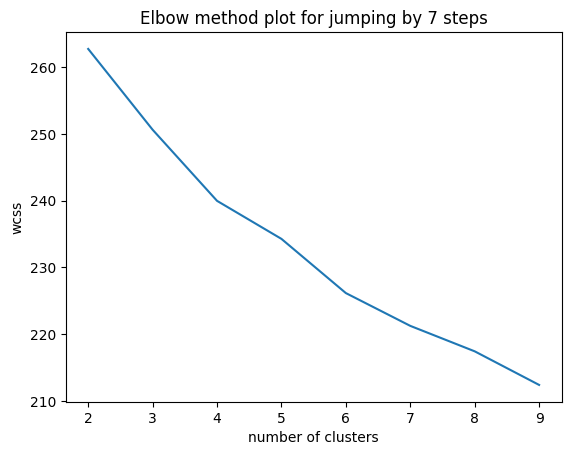

In [125]:
clust_nums = [2,3,4,5,6,7,8,9]
x_labels = []
y_labels = []
for num in clust_nums:
    kmeans = KMeans(num)
    kmeans.fit(differences_array.iloc[:,-14:])
    y_labels.append(kmeans.inertia_)
    x_labels.append(num)
plt.plot(x_labels,y_labels)
plt.title('Elbow method plot for jumping by 7 steps')
plt.xlabel("number of clusters")
plt.ylabel("wcss")
plt.savefig('C:/Users/hugma/diss/data/Elbow_plot_for_no_steps')

In [126]:
wcss_best = 10000000
labels_fin = []
cluster_centres_fin = []
for i in range(0,1000):
    kmeans = KMeans(3)
    kmeans.fit(differences_array.iloc[:,-14:])
    labels = kmeans.labels_
    cluster_centres = kmeans.cluster_centers_
    wcss = kmeans.inertia_
    if wcss< wcss_best:
        wcss_best = wcss
        labels_fin = labels
        cluster_centres_fin = cluster_centres
differences_array_MI['labels unnormalised vectors'] = labels_fin


In [127]:
point_colours = []
for i in labels_fin:
    point_colours.append(colours[i])

In [128]:
magnitudes = np.linalg.norm(differences_array.iloc[:,-14:], axis=1)

# Replace any zeros with ones to avoid division by zero
magnitudes[magnitudes == 0] = 1

# Normalize each row to have the same magnitude
normalized_df = differences_array.iloc[:,-14:].div(magnitudes, axis=0)

In [129]:
result = differences_array.iloc[:, -14:].dot(principal_components)
print(result.shape)
print(result.head())

(3308, 2)
           0         1
0  -0.165887  0.147273
7  -0.302762  0.108886
14 -0.300618  0.202614
21 -0.411555  0.026707
28 -0.537555 -0.012111


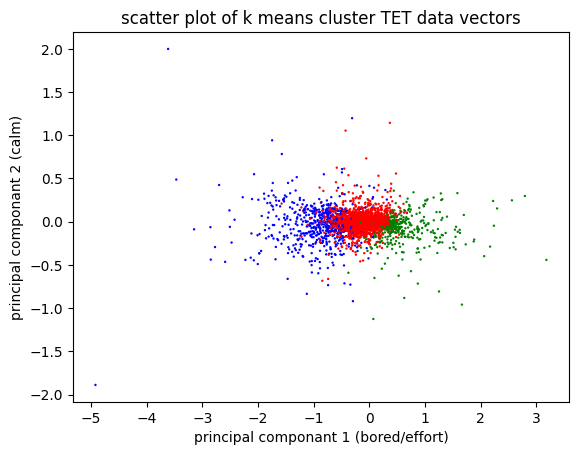

In [130]:
differences_array[["principal componant 1", "principal componant 2"]] = differences_array.iloc[:,-14:].dot(principal_components)
plt.xlabel("principal componant 1 (bored/effort)")
plt.ylabel("principal componant 2 (calm)")
plt.title("scatter plot of k means cluster TET data vectors")
plt.scatter(differences_array["principal componant 1"],differences_array["principal componant 2"],color=point_colours, s=0.5)
plt.savefig("C:/Users/hugma/diss/data/K_means_vector_scatter_plot")

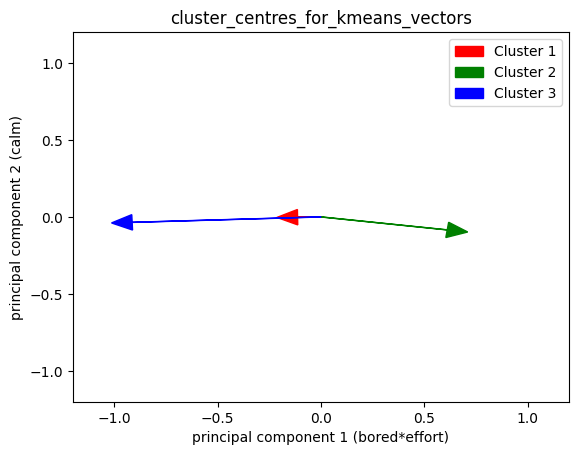

In [131]:
cluster_centres_prin = np.transpose(cluster_centres_fin.dot(principal_components),(1,0))
for i in range(cluster_centres_prin.shape[1]):
    plt.arrow(0, 0, cluster_centres_prin[0,i], cluster_centres_prin[1,i],
              head_width=0.1, head_length=0.1, fc=colours_list[i], ec=colours_list[i])

# Set the labels for the axes
plt.xlabel("principal component 1 (bored*effort)")
plt.ylabel("principal component 2 (calm)")

# Create the legend
legend = ['Cluster {}'.format(i+1) for i in range(cluster_centres_prin.shape[1])]
plt.legend(legend)
plt.title("cluster_centres_for_kmeans_vectors")
plt.xlim(-1.2,1.2)
plt.ylim(-1.2,1.2)
plt.savefig("c:/Users/hugma/diss/data/cluster_centres_for_kmeans_vectors")

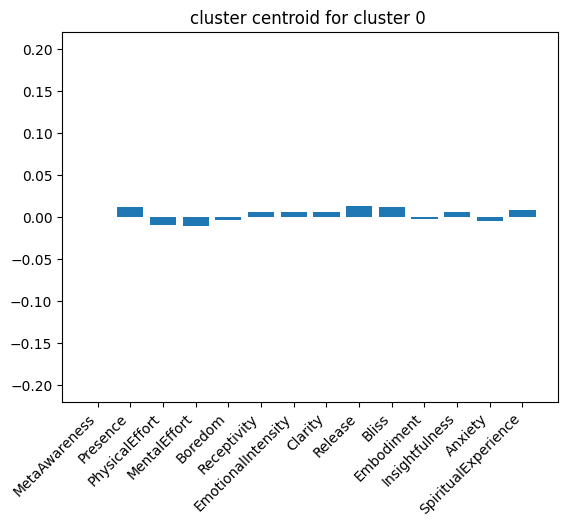

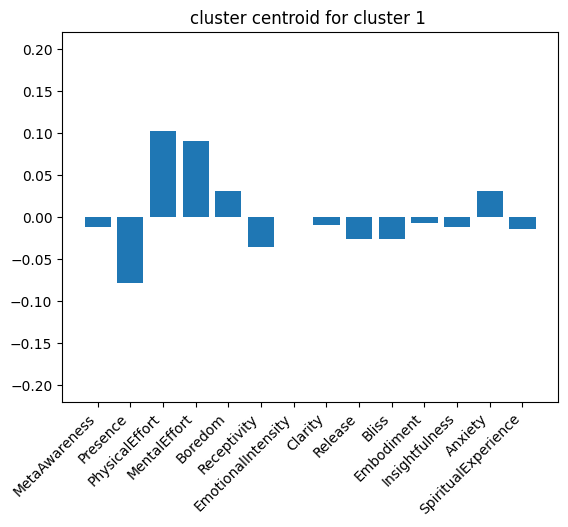

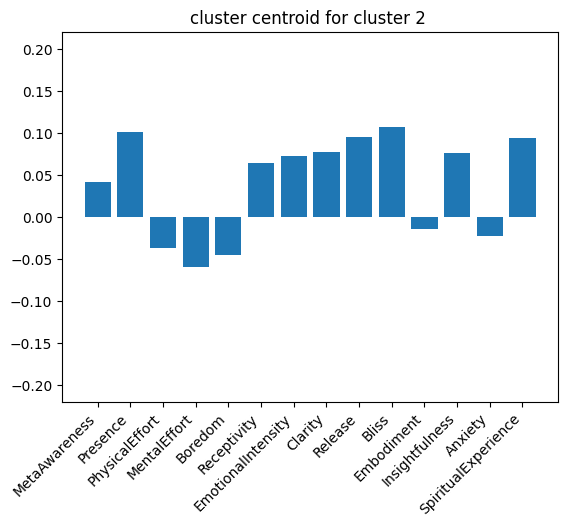

In [132]:
for i in range(0,cluster_centres_fin.shape[0]): 
    plt.figure() 
    plt.bar(feelings,cluster_centres_fin[i])
    plt.ylim(-0.22,0.22)
    plt.xticks(rotation=45, ha='right')
    plt.title(f"cluster centroid for cluster {i} ")
    plt.savefig(f'C:/Users/hugma/diss/data/Vector_Cluster_Centroids_{i}')

In [133]:
magnitudes = []
for i in range (len(cluster_centres_fin)):
    magnitudes.append(np.linalg.norm(cluster_centres_fin[i]))
stable_cluster = np.argmin(magnitudes)

In [134]:
differences_array['clust'] = labels_fin

df_stable = differences_array[differences_array['clust'] == stable_cluster].copy() 
wcss_best = float('inf') 
for i in range(1000):
    kmeans = KMeans(2)
    kmeans.fit(df_stable[feelings])
    labels_test = kmeans.labels_
    cluster_centres = kmeans.cluster_centers_
    wcss = kmeans.inertia_
    if wcss < wcss_best:
        wcss_best = wcss
        labels_fin_stable = labels_test
        cluster_centres_fin_stable = cluster_centres
df_stable = df_stable.drop('clust', axis=1)
df_stable['clust'] = [stable_cluster if label == 0 else 3 for label in labels_fin_stable]

differences_array.update(df_stable)


C:\Users\hugma\AppData\Local\Temp\ipykernel_18280\810337080.py:18: FutureWarning: Downcasting behavior in Series and DataFrame methods 'where', 'mask', and 'clip' is deprecated. In a future version this will not infer object dtypes or cast all-round floats to integers. Instead call result.infer_objects(copy=False) for object inference, or cast round floats explicitly. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  differences_array.update(df_stable)
C:\Users\hugma\AppData\Local\Temp\ipykernel_18280\810337080.py:18: FutureWarning: Downcasting behavior in Series and DataFrame methods 'where', 'mask', and 'clip' is deprecated. In a future version this will not infer object dtypes or cast all-round floats to integers. Instead call result.infer_objects(copy=False) for object inference, or cast round floats explicitly. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  differences_array.update(df_stable

In [170]:
differences_array['clust']

0        3
7        2
14       2
21       3
28       3
        ..
24082    2
24089    3
24096    3
24103    1
24110    1
Name: clust, Length: 3308, dtype: int64

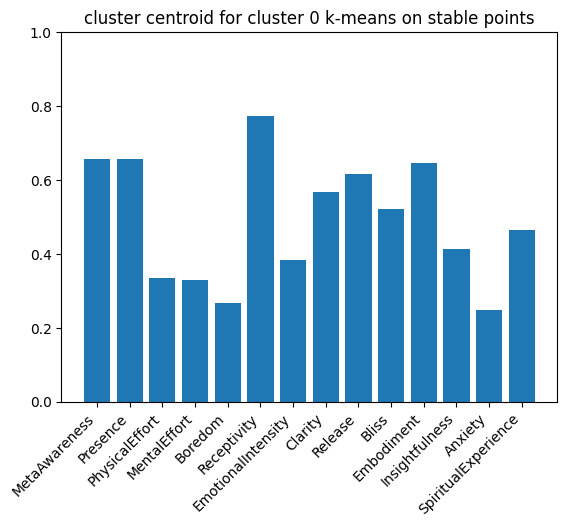

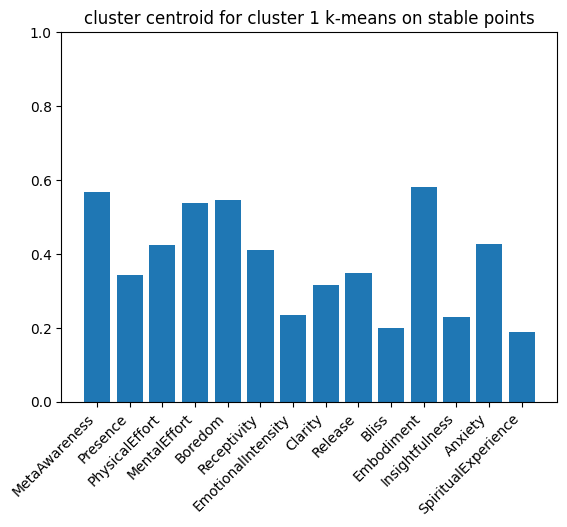

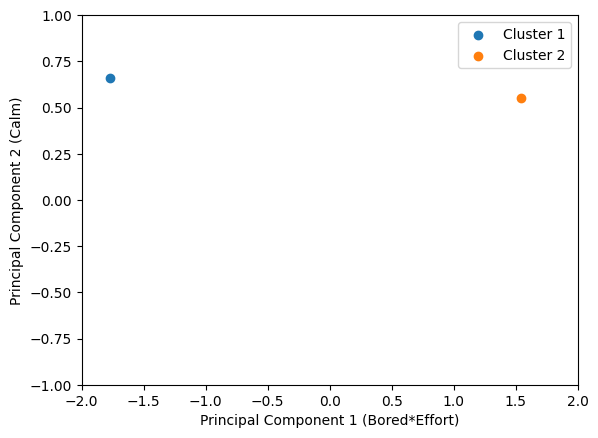

In [135]:
for i in range(0,cluster_centres_fin_stable.shape[0]): 
    plt.figure() 
    plt.bar(feelings,cluster_centres_fin_stable[i])
    plt.xticks(rotation=45, ha='right')
    plt.ylim(0,1)
    plt.title(f"cluster centroid for cluster {i} k-means on stable points")
    plt.savefig(f'C:/Users/hugma/diss/data/Cluster_Centroids_for_stable_cluster_{i}')
cluster_centres_prin_stable = np.transpose(cluster_centres_fin_stable.dot(principal_components),(1,0))
plt.figure()

# Assuming cluster_centres_prin_stable is an array with shape (2, n_clusters)
# where n_clusters is the number of clusters
for i in range(cluster_centres_prin_stable.shape[1]):
    plt.scatter(cluster_centres_prin_stable[0, i], cluster_centres_prin_stable[1, i], label=f'Cluster {i+1}')

plt.xlabel("Principal Component 1 (Bored*Effort)")
plt.ylabel("Principal Component 2 (Calm)")
plt.xlim(-2,2)
plt.ylim(-1,1)
plt.legend()  # This will add the legend to your plot
plt.savefig('C:/Users/hugma/diss/data/stable_cluster_centroids')
plt.show()


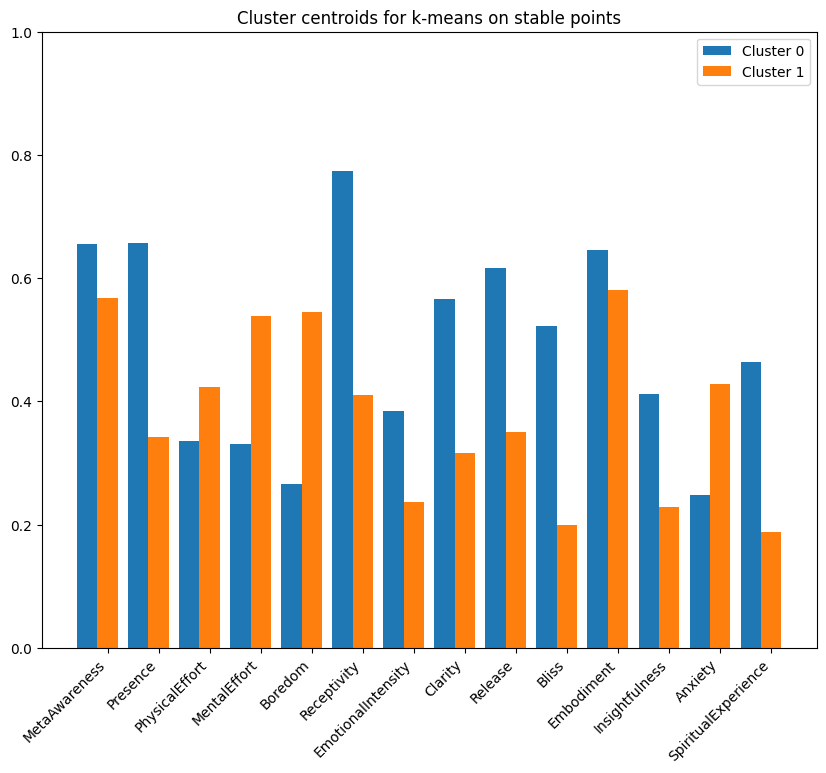

In [136]:
num_clusters = cluster_centres_fin_stable.shape[0]
num_feelings = len(feelings)
bar_width = 0.8 / num_clusters  # Adjust width for clarity
offset = np.arange(num_feelings)  # Base offset for each group of bars

plt.figure(figsize=(10, 8))  # Consider adjusting the size for clarity

for i in range(num_clusters):
    # Calculate the position for each cluster's bars
    positions = [pos + (bar_width * i) for pos in offset]
    
    # Plot bars for the current cluster
    plt.bar(positions, cluster_centres_fin_stable[i], width=bar_width, label=f'Cluster {i}')

plt.xticks(offset + bar_width * num_clusters / 2, feelings, rotation=45, ha='right')  # Adjust tick positions and labels
plt.ylim(0, 1)
plt.title("Cluster centroids for k-means on stable points")
plt.legend()
plt.savefig('C:/Users/hugma/diss/data/Cluster_Centroids_Bar_plot')
plt.show()

In [137]:
stable_cluster

0

In [138]:

transitions = []
for i in range(len(differences_array) - 1):
   transitions.append((differences_array.iloc[i]['clust'], differences_array.iloc[i+1]['clust']))
num_clusters = max(differences_array['clust']) + 1 

transition_matrix = np.zeros((num_clusters, num_clusters))

for (from_cluster, to_cluster) in transitions:
    transition_matrix[from_cluster, to_cluster] += 1

transition_matrix = transition_matrix / transition_matrix.sum(axis=1, keepdims=True)

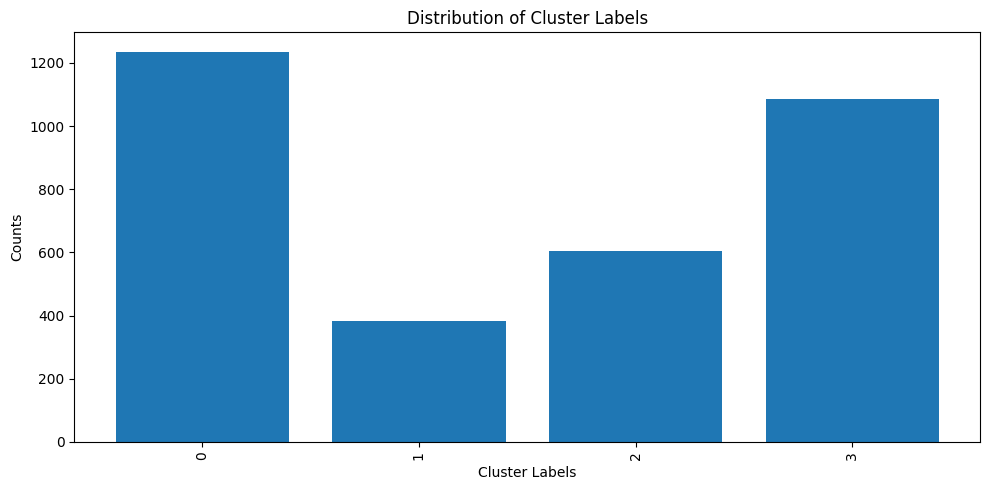

In [139]:
(unique, counts) = np.unique(differences_array['clust'], return_counts=True)
label_counts = dict(zip(unique, counts))

# Convert keys and values to lists for plotting
labels = list(label_counts.keys())
counts = list(label_counts.values())

# Creating the bar plot
plt.figure(figsize=(10, 5))  # Optional: Adjust figure size as needed
plt.bar(labels, counts)

# Setting x-axis labels to reflect discrete labels
plt.xticks(ticks=np.arange(len(labels)), labels=labels, rotation='vertical')  # Rotate labels if there are many or they are long

# Adding labels and title for clarity
plt.xlabel('Cluster Labels')
plt.ylabel('Counts')
plt.title('Distribution of Cluster Labels')

# Show the plot
plt.tight_layout()
plt.savefig("C:/Users/hugma/diss/data/Cluster_counts")

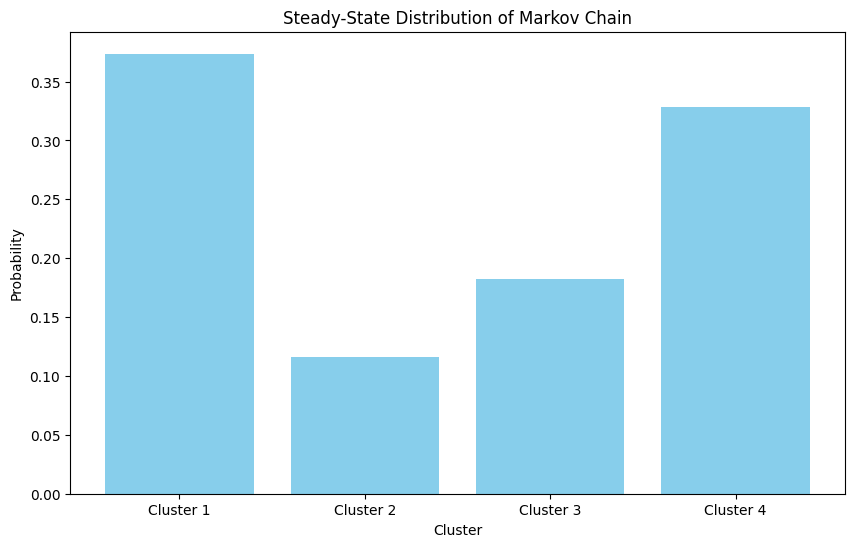

In [140]:
n = transition_matrix.shape[0]
A = transition_matrix.T - np.eye(n)
A[-1] = np.ones(n)
b = np.zeros(n)
b[-1] = 1
pi = np.linalg.solve(A, b)
pi
plt.figure(figsize=(10, 6))
clusters = [f'Cluster {i+1}' for i in range(n)]
plt.bar(clusters, pi, color='skyblue')
plt.xlabel('Cluster')
plt.ylabel('Probability')
plt.title('Steady-State Distribution of Markov Chain')
plt.savefig("C:/Users/hugma/diss/data/steady-state distrbution for markov chain for kmeans clustering TET vectors")

In [141]:
differences_array_transitions = differences_array_MI[:-1].copy()

differences_array_transitions['transitions'] = transitions
differences_array_transitions.to_csv('c:/Users/hugma/diss/data/differences_array_transitions.csv',index=False)

In [142]:
feelings_diffs = ['MetaAwareness_diff', 'Presence_diff', 'PhysicalEffort_diff',
       'MentalEffort_diff', 'Boredom_diff', 'Receptivity_diff',
       'EmotionalIntensity_diff', 'Clarity_diff', 'Release_diff', 'Bliss_diff',
       'Embodiment_diff', 'Insightfulness_diff', 'Anxiety_diff',
       'SpiritualExperience_diff']
transitions_dict = {}
transitions_next_dict = {}
array_store = []
for heading, group in differences_array_transitions.groupby('transitions'):
    transitions_dict[heading] = group.copy()
for key, values in transitions_dict.items():
    frames = []  # List to store DataFrames for each iteration
    for index, value in values.iterrows():
        row_data = differences_array_MI[differences_array_MI['number'] == value['number']+1][feelings_diffs]
        frames.append(row_data)
    transitions_next_dict[key] = pd.concat(frames, axis=0)


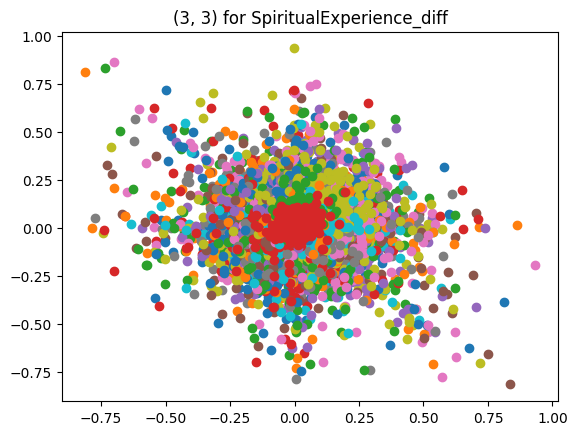

In [143]:
for feeling in feelings_diffs:    
    for key, value in transitions_next_dict.items():
    
        plt.scatter(transitions_dict[key][feeling],value[feeling])
        plt.title(f"{key} for {feeling}")


In [144]:
transitions_change_dict = {}

for key, values in transitions_next_dict.items():
    result = transitions_next_dict[key].values - transitions_dict[key][feelings_diffs].values
    result_df = pd.DataFrame(result, index=transitions_next_dict[key].index, columns=transitions_next_dict[key].columns)
    transitions_change_dict[key] = result_df


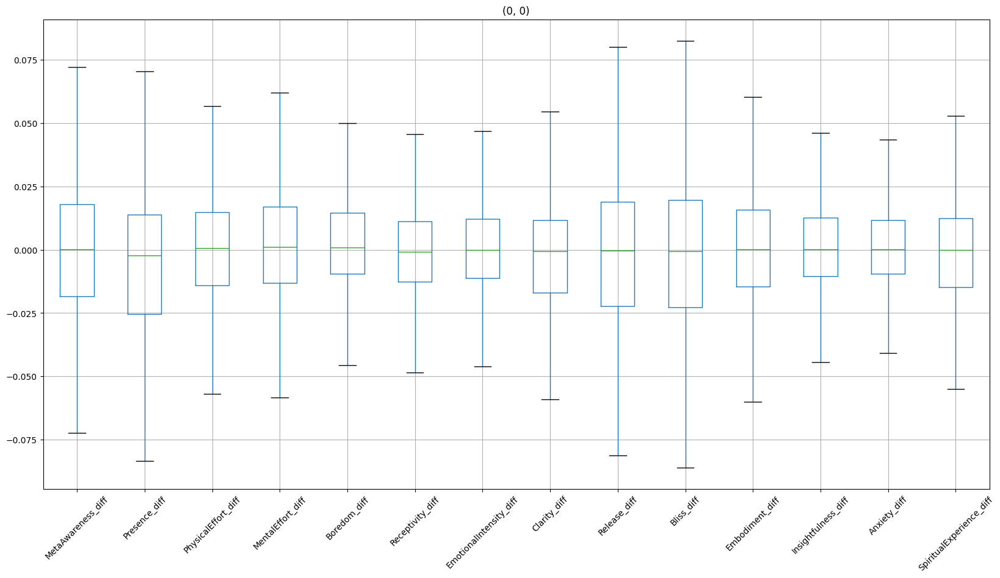

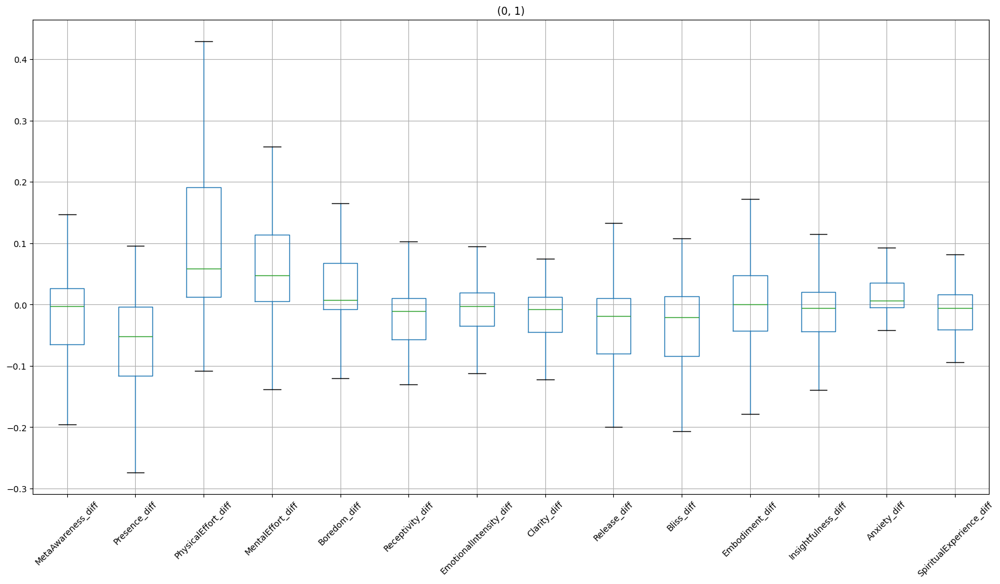

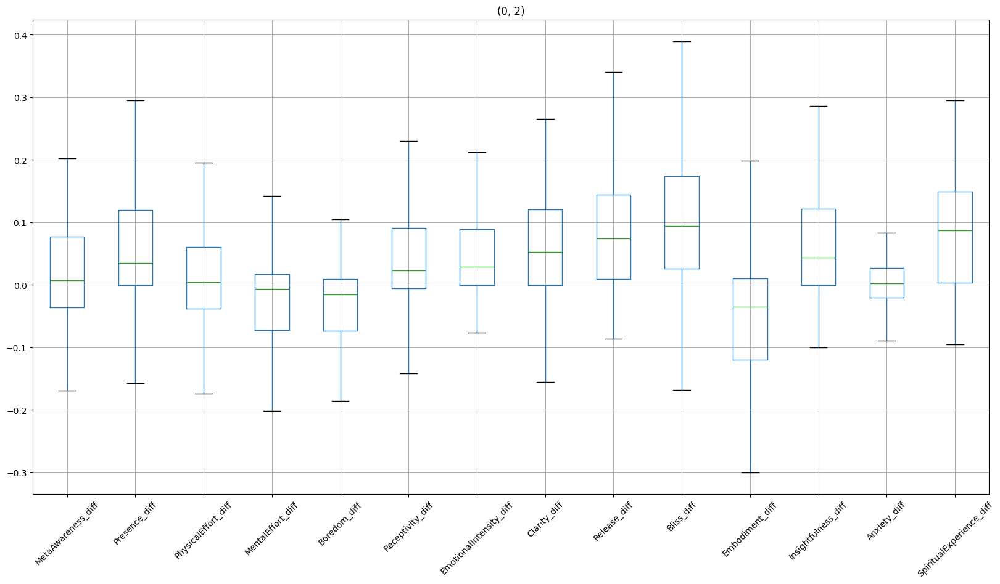

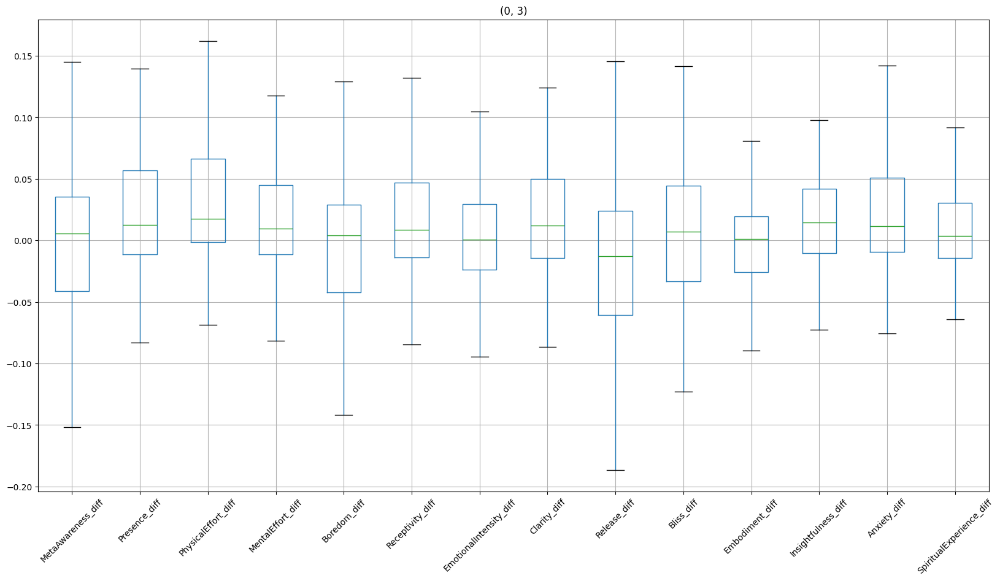

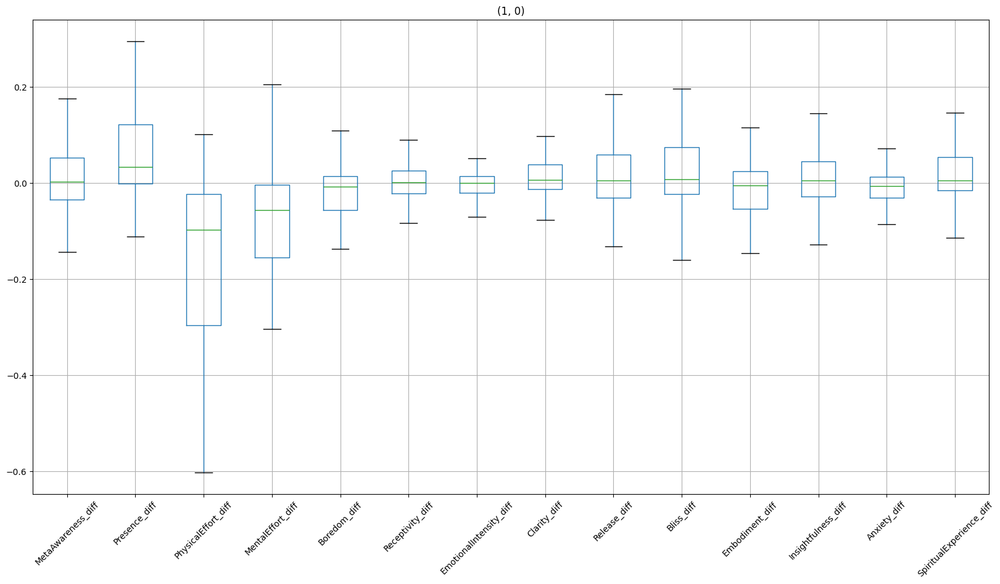

...

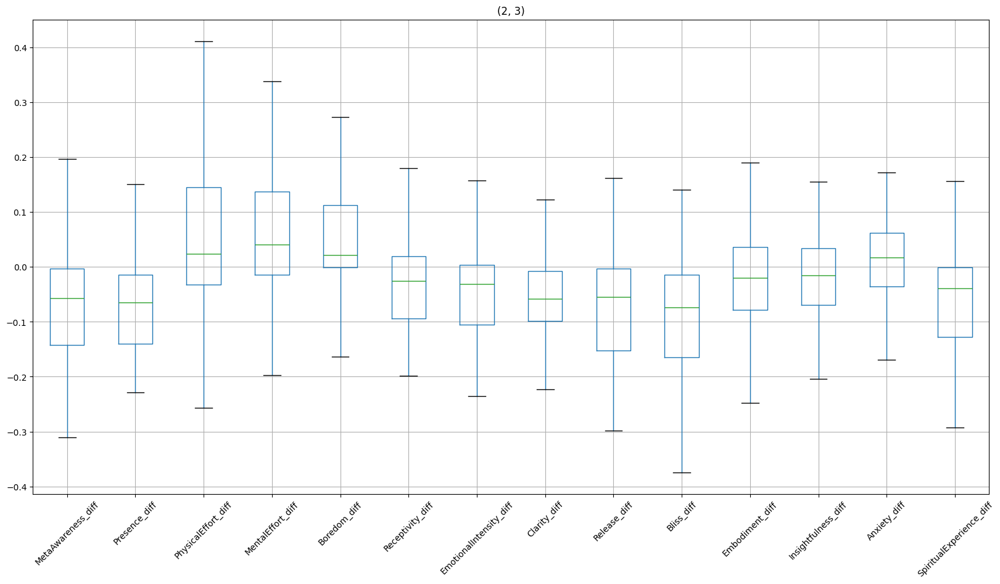

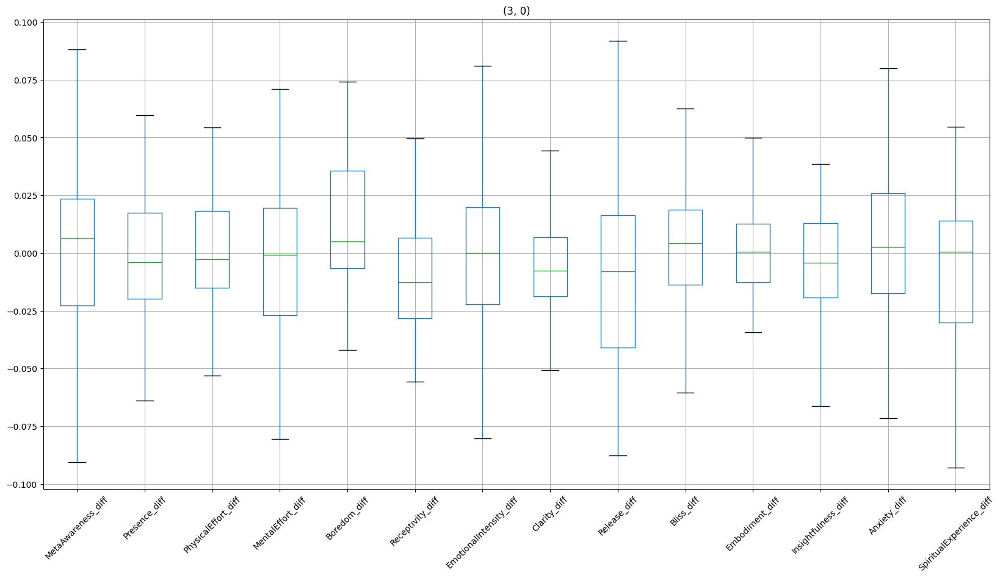

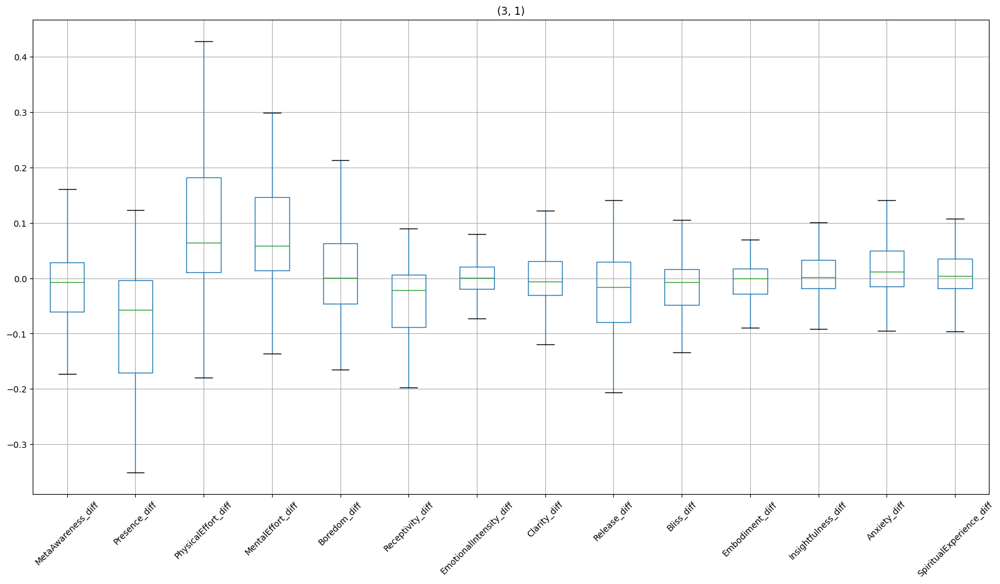

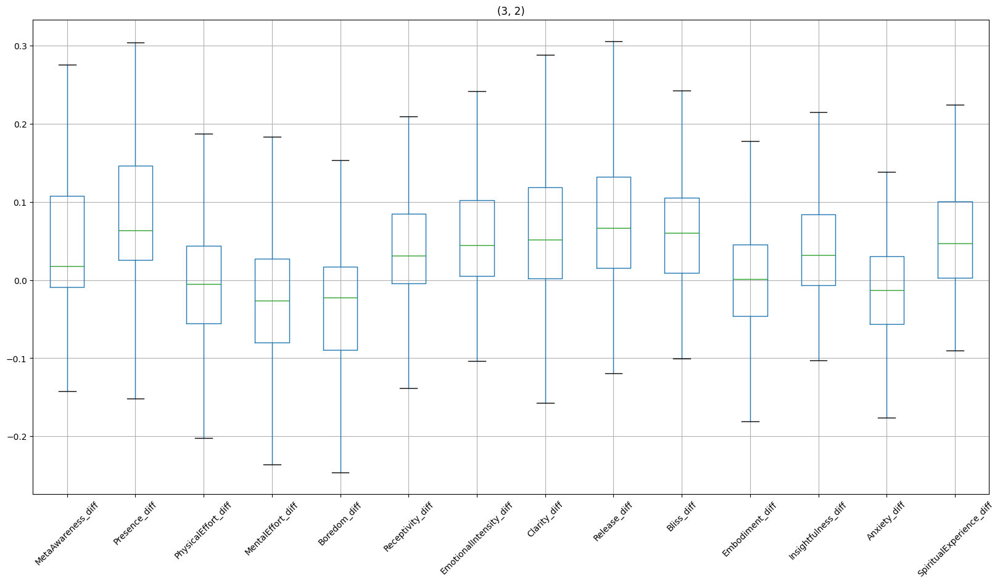

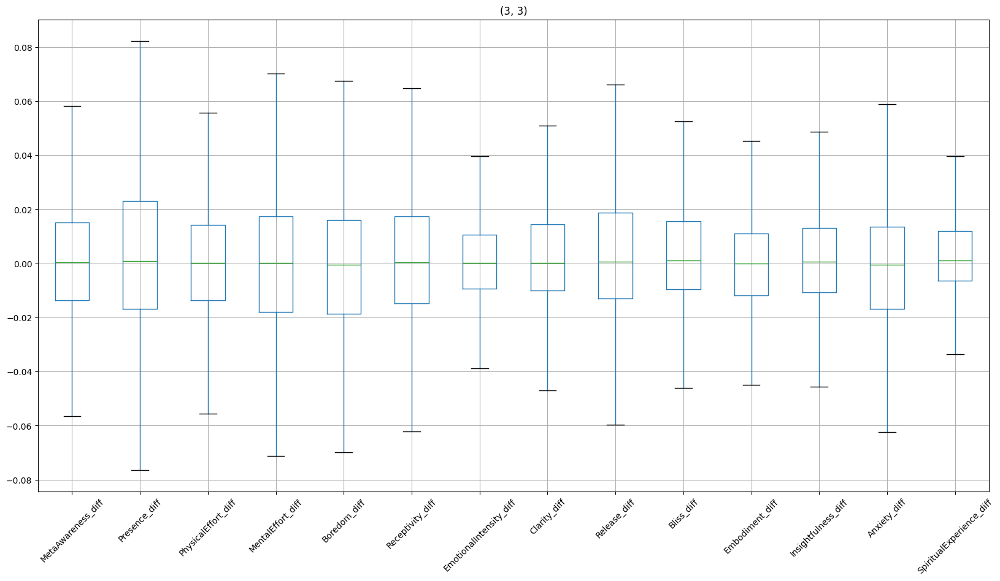

In [145]:
for key, values in transitions_change_dict.items():
    plt.figure(figsize=(20, 10))  # Adjust the size as needed
    values.boxplot(showfliers=False)
    plt.xticks(rotation=45)  # Rotate the column names for better readability
    plt.title(key)
    plt.savefig(f"C:/Users/hugma/diss/data/Cause_of_cluster_transition_{key}")
    plt.show()

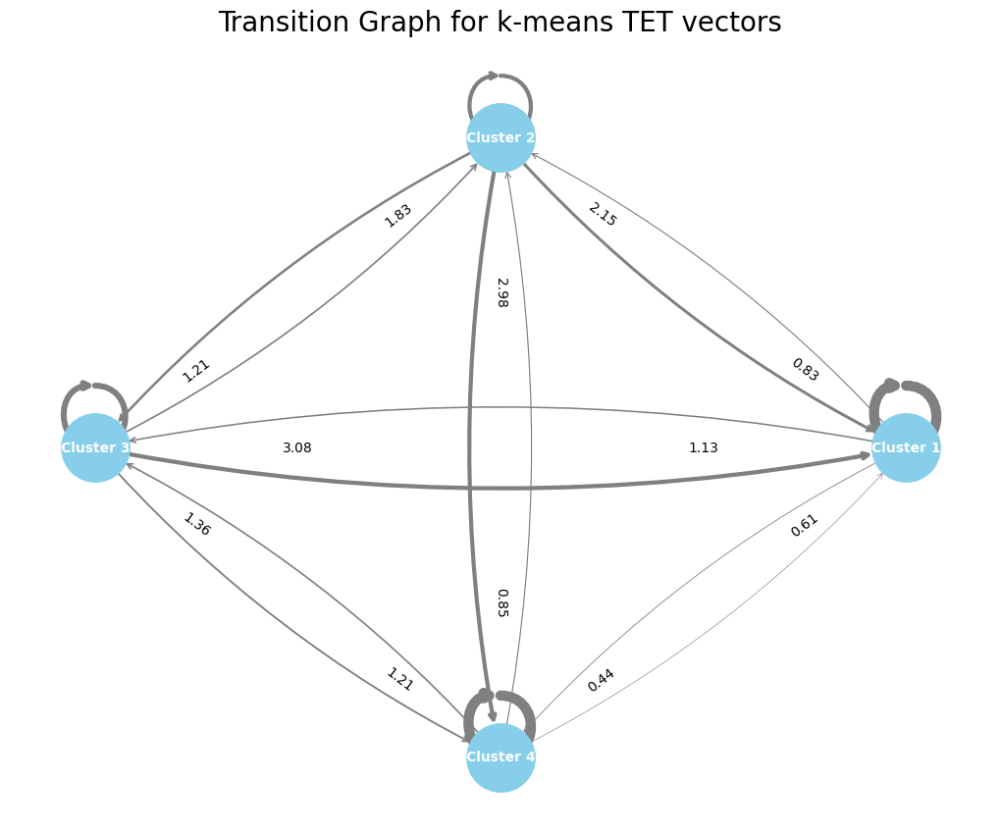

In [146]:
G = nx.DiGraph()

# Add nodes and edges with weights
for i in range(len(transition_matrix)):
    for j in range(len(transition_matrix[i])):
        prob = transition_matrix[i][j]
        if prob > 0:  # Only add an edge if the probability is non-zero
            # The edge width will be proportional to the probability
            G.add_edge(f'Cluster {i+1}', f'Cluster {j+1}', weight=prob*10)  # Multiply by a factor for better visualization

# Draw the graph
plt.figure(figsize=(10, 8))
pos = nx.circular_layout(G)  # Position nodes in a circle

# Extract weights and apply as widths
edge_weights = nx.get_edge_attributes(G, 'weight')
edge_widths = [edge_weights[edge] for edge in G.edges()]
edge_labels = {(u, v): f'{d["weight"]:.2f}' for u, v, d in G.edges(data=True)}

nx.draw(G, pos, node_color='skyblue', node_size=2500, width=edge_widths, arrowstyle='->', connectionstyle='arc3,rad=0.1', edge_color='grey')
nx.draw_networkx_labels(G, pos, font_size=10, font_weight='bold', font_color='white')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, label_pos=0.75, font_size=10)
# Remove the axis
plt.axis('off')

plt.title('Transition Graph for k-means TET vectors', size=20)
plt.savefig("C:/Users/hugma/diss/data/transition graph for markov chain for kmeans clustering TET vectors")
plt.show()




<Figure size 1000x800 with 0 Axes>

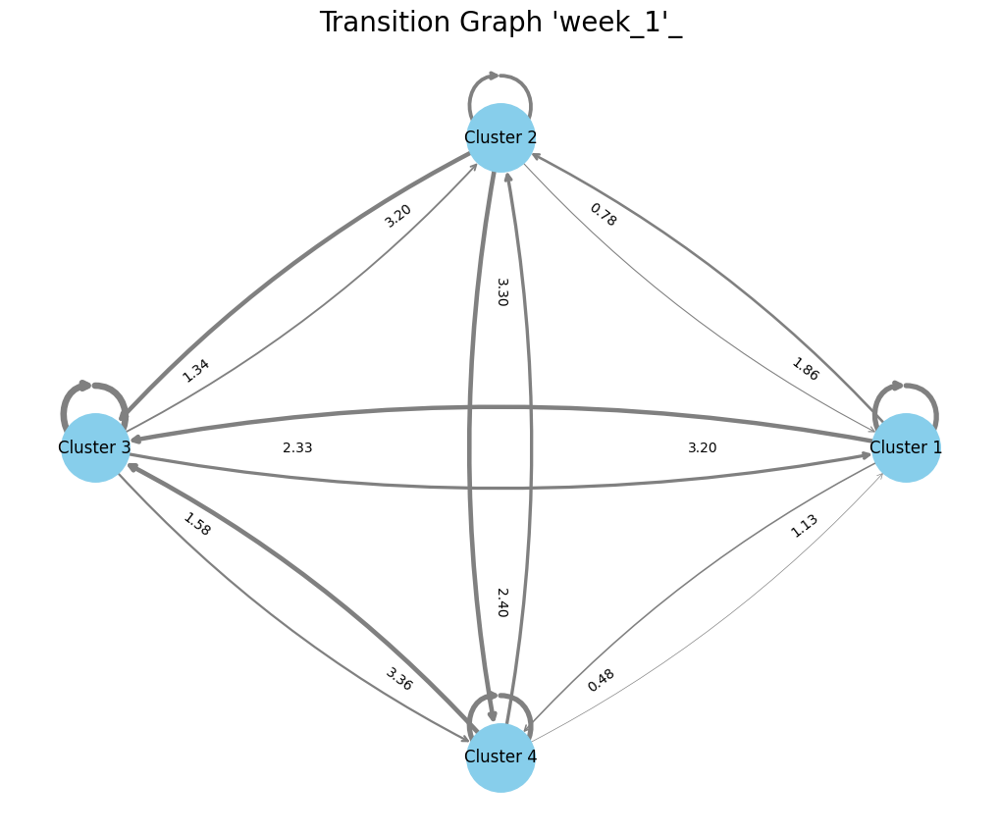

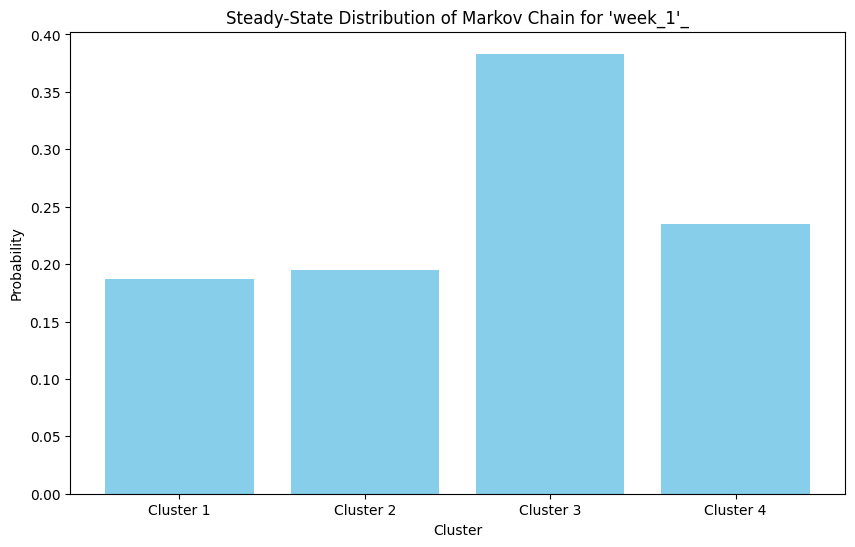

<Figure size 1000x800 with 0 Axes>

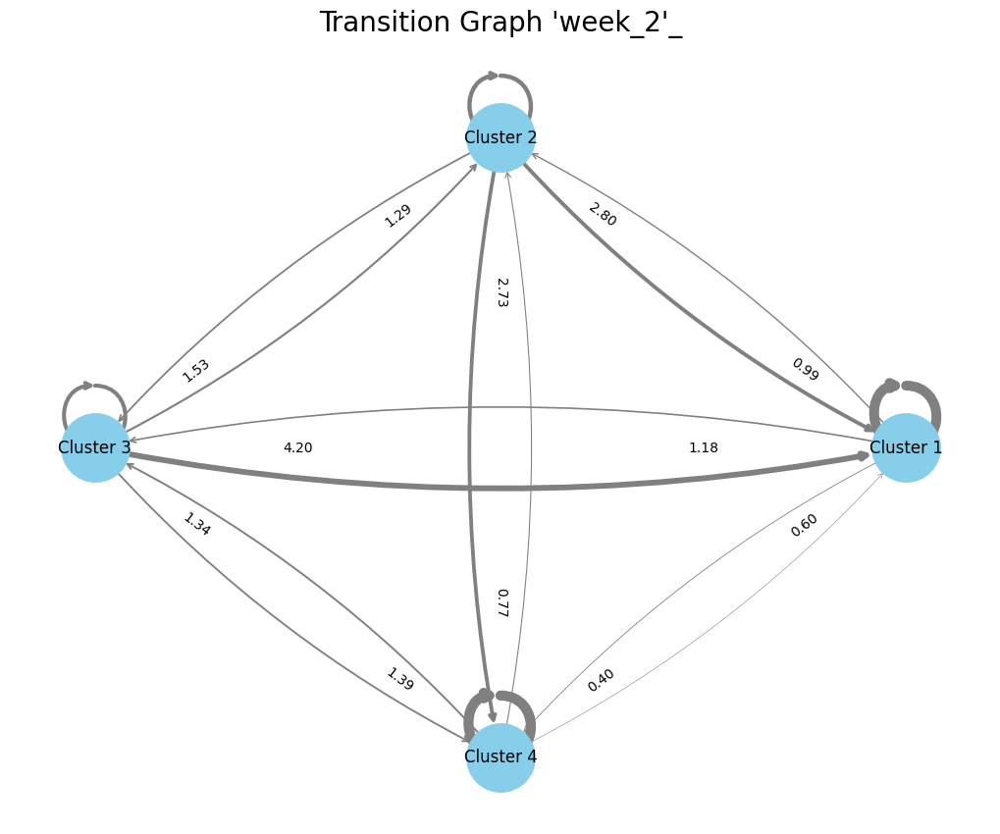

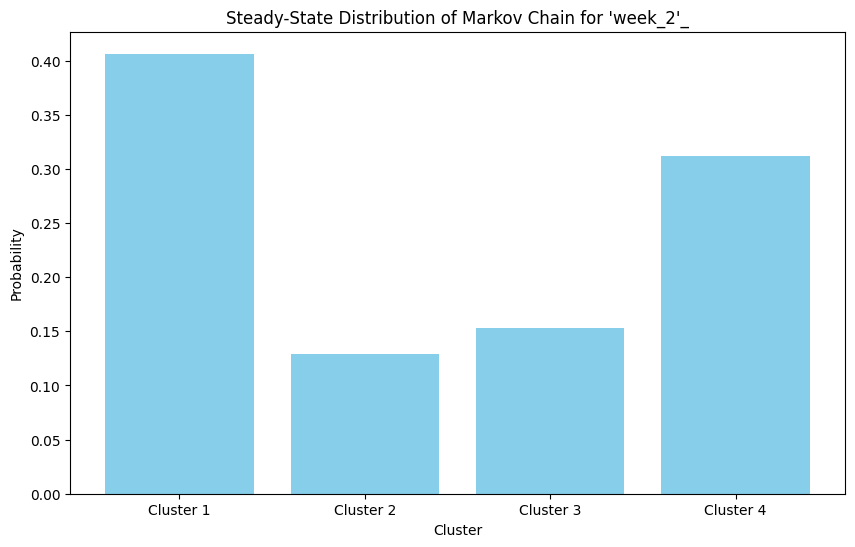

<Figure size 1000x800 with 0 Axes>

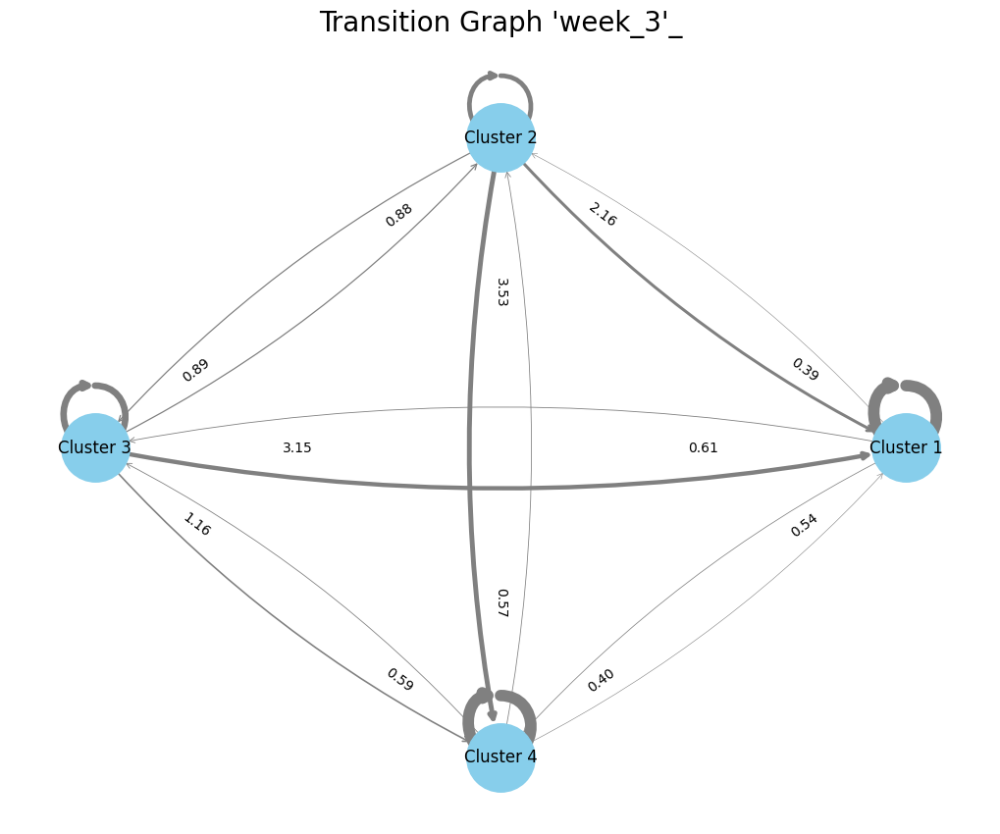

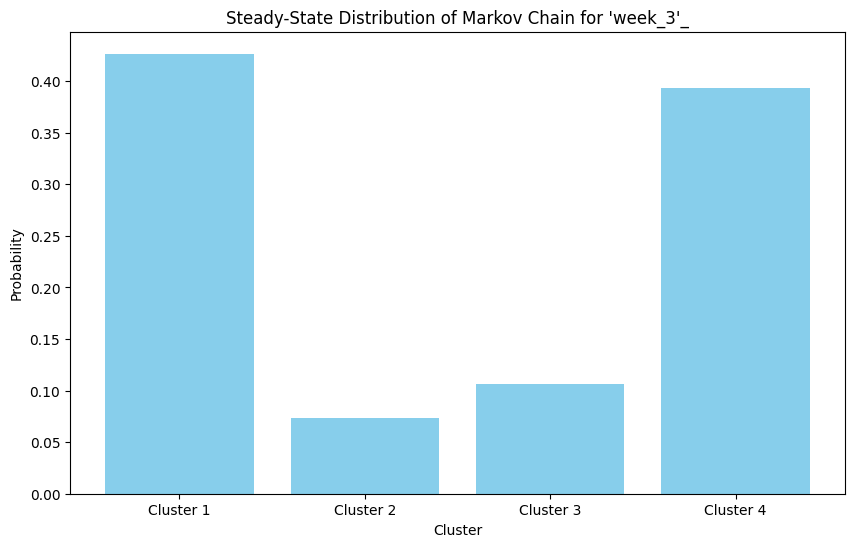

<Figure size 1000x800 with 0 Axes>

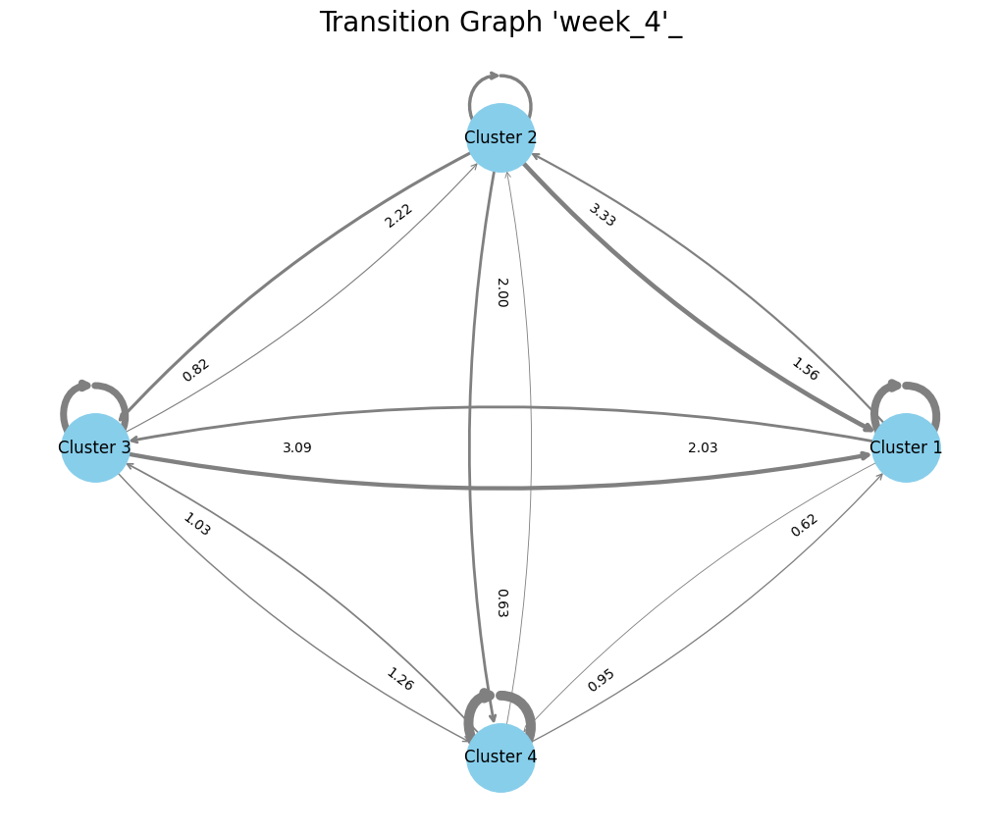

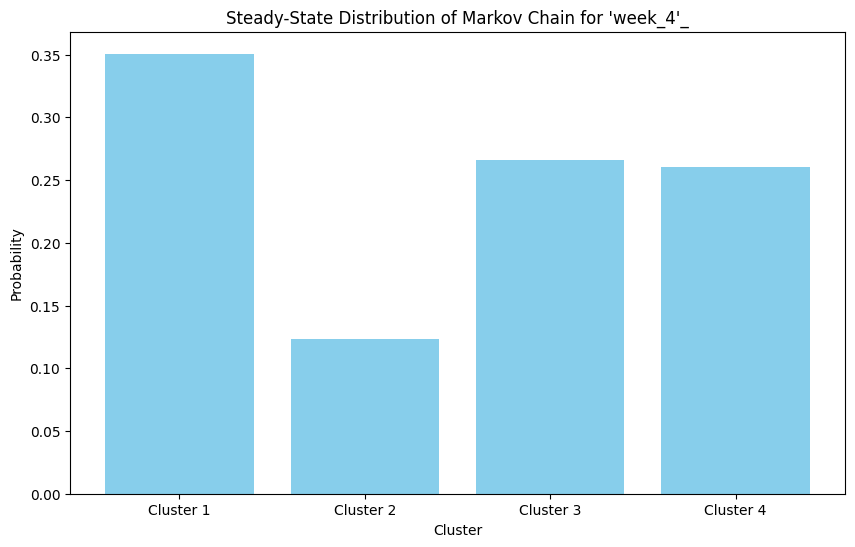

In [147]:
split_dict = {}
transition_matrices_dict = {}
for heading,group in differences_array.groupby([header]):
    split_dict[heading] = group.copy()
for key,value in split_dict.items():
    transitions_key = []
    for i in range(len(value) - 1):
        transitions_key.append((value.iloc[i]['clust'], value.iloc[i+1]['clust']))
        num_clusters = max(value['clust']) + 1 

    transition_matrix_key = np.zeros((num_clusters, num_clusters))

    for (from_cluster, to_cluster) in transitions_key:
        transition_matrix_key[from_cluster, to_cluster] += 1

    transition_matrix_key = transition_matrix_key / transition_matrix_key.sum(axis=1, keepdims=True)
    transition_matrices_dict[key] = transition_matrix_key
    G = nx.DiGraph()

    # Add nodes and edges with weights
    for i in range(len(transition_matrix_key)):
        for j in range(len(transition_matrix_key[i])):
            prob = transition_matrix_key[i][j]
            if prob > 0:  # Only add an edge if the probability is non-zero
                # The edge width will be proportional to the probability
                G.add_edge(f'Cluster {i+1}', f'Cluster {j+1}', weight=prob*10)  # Multiply by a factor for better visualization

    # Draw the graph
    plt.figure(figsize=(10, 8))
    pos = nx.circular_layout(G)  # Position nodes in a circle

    # Extract weights and apply as widths
    edge_weights = nx.get_edge_attributes(G, 'weight')
    edge_widths = [edge_weights[edge] for edge in G.edges()]

    edge_labels = {(u, v): f'{d["weight"]:.2f}' for u, v, d in G.edges(data=True)}


    plt.figure(figsize=(10, 8))
    nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=2500, width=edge_widths, arrowstyle='->', connectionstyle='arc3,rad=0.1', edge_color='grey')
   

    # Draw edge labels with corrected labels
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, label_pos=0.75, font_size=10)
    safe_key = str(key).replace("\\", "").replace("/", "").replace("(", "").replace(")", "").replace(",", "_")
    # Remove the axis
    plt.axis('off')

    plt.title(f'Transition Graph {safe_key}', size=20)
    plt.savefig(f"C:/Users/hugma/diss/data/Transition_Graph_{safe_key}")
    plt.show()
    
    n = transition_matrix_key.shape[0]
    A = transition_matrix_key.T - np.eye(n)
    A[-1] = np.ones(n)
    b = np.zeros(n)
    b[-1] = 1
    pi = np.linalg.solve(A, b)
    pi
    plt.figure(figsize=(10, 6))
    clusters = [f'Cluster {i+1}' for i in range(n)]
    plt.bar(clusters, pi, color='skyblue')
    plt.xlabel('Cluster')
    plt.ylabel('Probability')
    plt.title(f'Steady-State Distribution of Markov Chain for {safe_key}')
    plt.savefig(f"C:/Users/hugma/diss/data/Steady-State Distribution of Markov Chain for {safe_key}")
    plt.show()
    

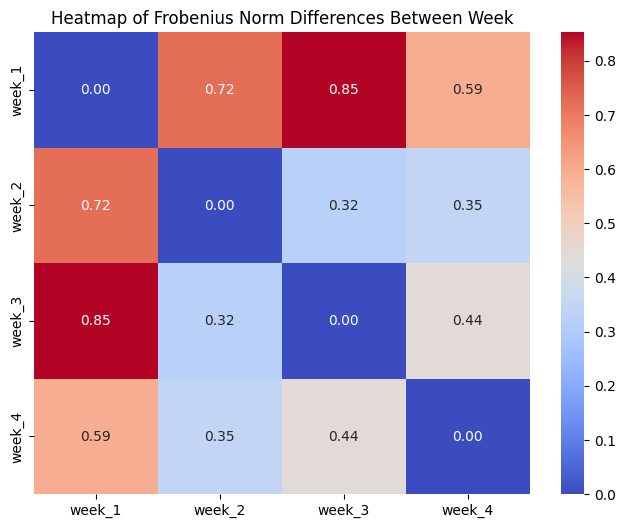

In [148]:
headers = list(transition_matrices_dict.keys())
frobenius_matrix = np.zeros((len(headers), len(headers)))

for i in range(len(headers)):
    for j in range(i + 1, len(headers)):
        diff_matrix = transition_matrices_dict[headers[i]] - transition_matrices_dict[headers[j]]
        frob_norm = np.linalg.norm(diff_matrix, 'fro')
        frobenius_matrix[i, j] = frob_norm
        frobenius_matrix[j, i] = frob_norm  
headers = [str(header).strip("(),'") for header in headers]
plt.figure(figsize=(8, 6))
ax = sns.heatmap(frobenius_matrix, annot=True, fmt=".2f", xticklabels=headers, yticklabels=headers, cmap="coolwarm")
plt.title(f'Heatmap of Frobenius Norm Differences Between {header}')
plt.savefig(f"C:/Users/hugma/diss/data/Heatmap of Frobenius Norm Differences Between {header}")
plt.show()


In [149]:
def calculate_nmi_for_labels(df, cluster_assignments_column, labels_of_interest):
    nmi_scores = {}
    for label in labels_of_interest:
        nmi_score = normalized_mutual_info_score(df[cluster_assignments_column], df[label], average_method='arithmetic')
        nmi_scores[label] = nmi_score
    return nmi_scores

In [150]:
def plot_nmi_scores(nmi_scores):
    labels = list(nmi_scores.keys())
    scores = list(nmi_scores.values())
    
    plt.figure(figsize=(10, 6))
    plt.bar(labels, scores, color='skyblue')
    plt.xlabel('Labels')
    plt.ylabel('Normalized Mutual Information Score')
    plt.title('NMI Scores Across Different Labels (Relevancy)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

C:\Users\hugma\AppData\Local\Temp\ipykernel_18280\33112758.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


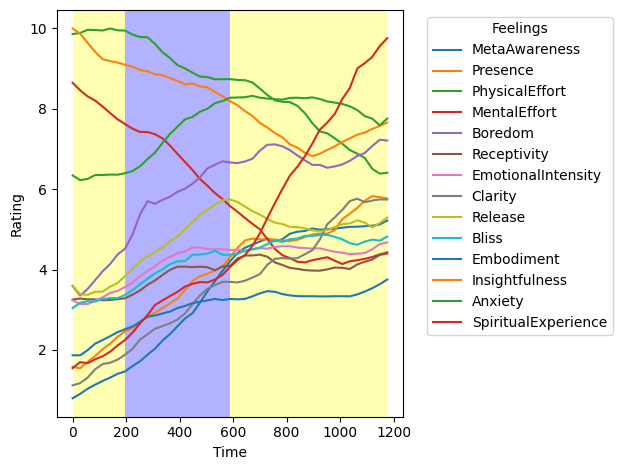

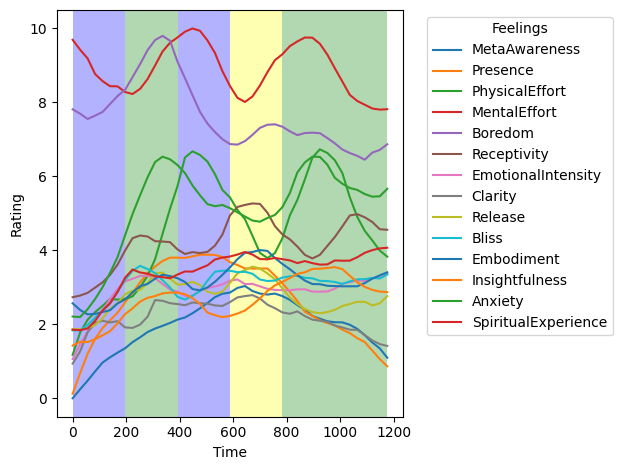

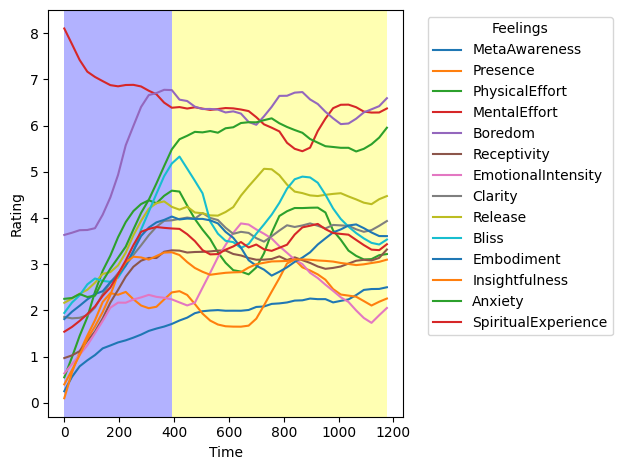

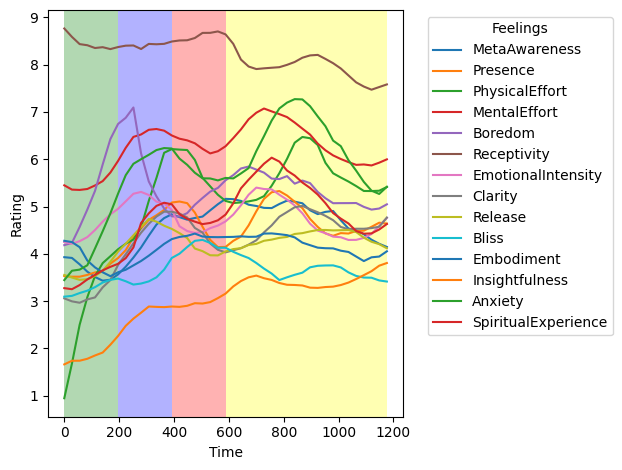

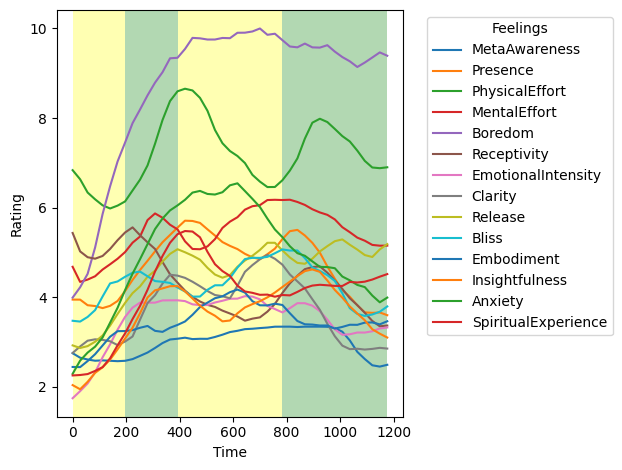

...

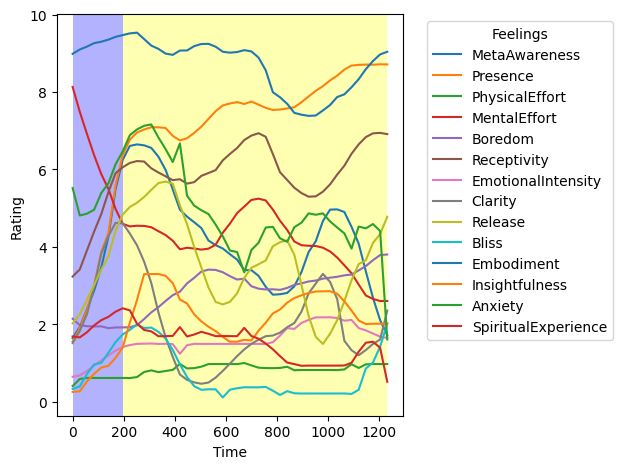

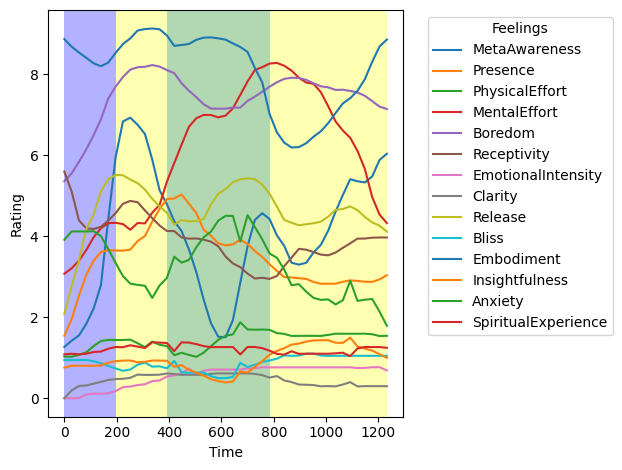

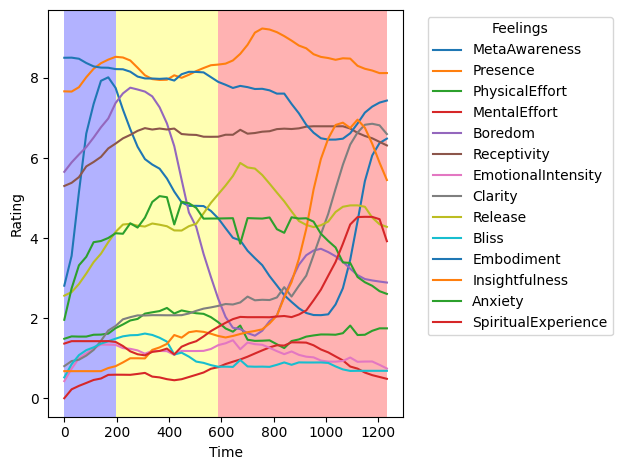

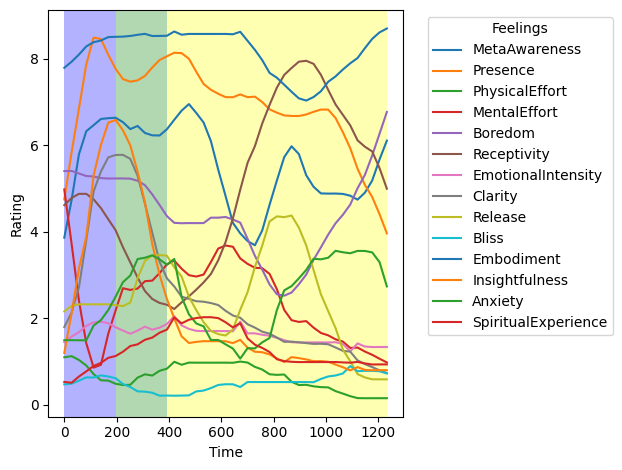

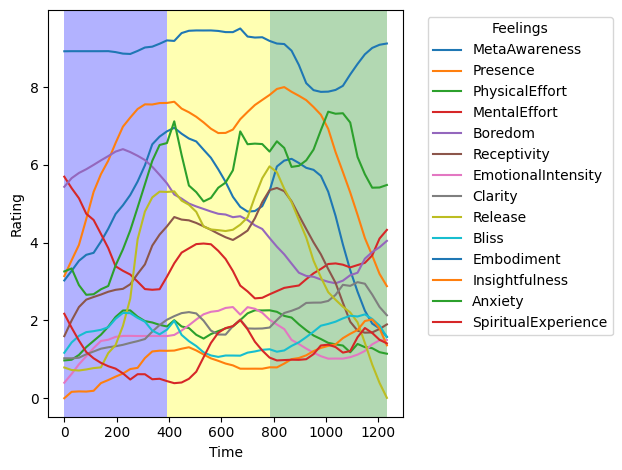

In [151]:
differences_array[["principal componant 1 non-diff", "principal componant 2 non-diff"]] = differences_array[feelings].dot(principal_components)
traj_transitions_dict = {}
traj_transitions_dict_original = {}
color_map = {
    0: 'red',
    1: 'green',
    2: 'blue',
    3: 'yellow',
    4: 'white'
}
for heading,group in df_csv_file_original.groupby(['Subject','Week','Session']):
    traj_transitions_dict_original[heading] = group
for heading,group in differences_array.groupby(['Subject','Week','Session']):
    traj_transitions_dict[heading] = group

for heading,value in traj_transitions_dict_original.items():
    plt.figure()
    for feeling in feelings:
        starting_time = 0 
        time_jump = 28
        time_array = np.arange(starting_time, starting_time + time_jump * value.shape[0], time_jump)
        plt.plot(time_array,value[feeling]*10,label=feeling)
    combined = ''.join(header)


    cleaned = combined.replace("\\", "").replace("'", "").replace(" ", "").replace("(", "").replace(")", "")
    plt.legend(title='Feelings', bbox_to_anchor=(1.05, 1), loc='upper left')  
    plt.xlabel('Time')
    plt.ylabel('Rating')
    plt.tight_layout() 
    plt.savefig(f"C:/Users/hugma/diss/data/{cleaned}")
    
    
    prev_color_val = traj_transitions_dict[heading]['clust'].iloc[0]
    start_index = 0
    for index, color_val in enumerate(traj_transitions_dict[heading]['clust']):
        if color_val != prev_color_val or index == traj_transitions_dict[heading].shape[0] - 1:
            # Only go up to the previous index if it's not the last span
            end_index = index*(time_jump*no_of_jumps) if index != traj_transitions_dict[heading].shape[0] - 1 else time_array[-1]
            plt.axvspan(start_index*(time_jump*no_of_jumps), end_index, facecolor=color_map[prev_color_val], alpha=0.3)
            start_index = index
            prev_color_val = color_val

In [175]:
traj_transitions_dict_original['s01\\',
  'week_1',
  'run_01']

,Subject,Week,Session,Condition,MetaAwareness,Presence,PhysicalEffort,MentalEffort,Boredom,Receptivity,...,theta,alpha,beta,gamma,offset,exponent,Cluster,BH_Num,before_or_after,Cluster_Label
0,s01\,week_1,run_01,Intro,0.079752,0.157927,0.986157,0.864791,0.358931,0.325571,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,3.0
1,s01\,week_1,run_01,Intro,0.090521,0.154184,0.988758,0.846303,0.335205,0.327787,...,NaN,NaN,0.672414,NaN,3.621908,2.347230,2,NaN,NaN,3.0
2,s01\,week_1,run_01,Breath,0.103346,0.170191,0.996748,0.830982,0.351663,0.325911,...,0.460067,NaN,0.688761,NaN,3.239157,2.322005,2,NaN,NaN,3.0
3,s01\,week_1,run_01,Breath,0.113467,0.184691,0.996189,0.820543,0.373540,0.325817,...,0.454785,0.318854,0.544952,NaN,3.467290,2.343427,2,NaN,NaN,3.0
4,s01\,week_1,run_01,Breath,0.122709,0.201506,0.994991,0.805797,0.395632,0.323555,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,3.0
5,s01\,week_1,run_01,Breath,0.131016,0.215564,1.000000,0.789672,0.413669,0.324230,...,0.383112,0.373777,0.880069,NaN,3.366541,2.293092,2,NaN,NaN,3.0
6,s01\,week_1,run_01,Breath,0.140421,0.232716,0.995477,0.773816,0.437407,0.326418,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,3.0
7,s01\,week_1,run_01,Breath,0.146483,0.246589,0.994702,0.762033,0.452063,0.328492,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,2.0
8,s01\,week_1,run_01,Breath,0.159931,0.254412,0.984740,0.750584,0.487545,0.337645,...,0.576127,0.251023,0.665869,NaN,3.021526,2.138718,2,NaN,NaN,2.0
9,s01\,week_1,run_01,Breath,0.171834,0.270018,0.978822,0.742503,0.537554,0.347985,...,0.677782,0.251291,0.616837,NaN,2.512758,1.858621,2,NaN,NaN,2.0


,Subject,Week,Session,Condition,MetaAwareness,Presence,PhysicalEffort,MentalEffort,Boredom,Receptivity,...,Bliss_diff,Embodiment_diff,Insightfulness_diff,Anxiety_diff,SpiritualExperience_diff,principal componant 1,principal componant 2,clust,principal componant 1 non-diff,principal componant 2 non-diff
0,s01\,week_1,run_01,Intro,0.079752,0.157927,0.986157,0.864791,0.358931,0.325571,...,0.032474,0.064964,-0.090323,0.005483,0.070108,-0.165887,0.147273,3,2.223860,-0.966742
7,s01\,week_1,run_01,Breath,0.146483,0.246589,0.994702,0.762033,0.452063,0.328492,...,0.083917,0.052581,-0.040031,0.115890,0.119685,-0.302762,0.108886,2,2.057974,-0.819469
14,s01\,week_1,run_01,Hold,0.258907,0.328468,0.908909,0.687913,0.593582,0.407142,...,0.016376,0.022831,-0.050252,0.071855,0.061747,-0.300618,0.202614,2,1.755212,-0.710584
21,s01\,week_1,run_01,Breath,0.420263,0.430379,0.873992,0.558102,0.666732,0.408880,...,0.031875,0.011983,-0.090251,-0.004489,0.194288,-0.411555,0.026707,3,1.454594,-0.507969
28,s01\,week_1,run_01,Breath,0.475315,0.472148,0.817596,0.435732,0.706880,0.411510,...,0.012578,-0.005232,-0.022293,-0.007465,0.187037,-0.537555,-0.012111,3,1.043039,-0.481262
35,s01\,week_1,run_01,END,0.501921,0.498502,0.726491,0.421842,0.656783,0.404984,...,0.000615,0.041671,0.059024,-0.039551,0.188419,-0.409252,-0.015752,2,0.505484,-0.493373


In [169]:
df_csv_file_original.to_csv("C:/Users/hugma/diss/final/df_csv_file_original.csv", index=False)

In [168]:
df_csv_file_original

,Subject,Week,Session,Condition,MetaAwareness,Presence,PhysicalEffort,MentalEffort,Boredom,Receptivity,...,theta,alpha,beta,gamma,offset,exponent,Cluster,BH_Num,before_or_after,Cluster_Label
0,s01\,week_1,run_01,Intro,0.079752,0.157927,0.986157,0.864791,0.358931,0.325571,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,3.0
1,s01\,week_1,run_01,Intro,0.090521,0.154184,0.988758,0.846303,0.335205,0.327787,...,NaN,NaN,0.672414,NaN,3.621908,2.347230,2,NaN,NaN,3.0
2,s01\,week_1,run_01,Breath,0.103346,0.170191,0.996748,0.830982,0.351663,0.325911,...,0.460067,NaN,0.688761,NaN,3.239157,2.322005,2,NaN,NaN,3.0
3,s01\,week_1,run_01,Breath,0.113467,0.184691,0.996189,0.820543,0.373540,0.325817,...,0.454785,0.318854,0.544952,NaN,3.467290,2.343427,2,NaN,NaN,3.0
4,s01\,week_1,run_01,Breath,0.122709,0.201506,0.994991,0.805797,0.395632,0.323555,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24115,s21\,week_4,run_06,END,0.273993,0.471893,0.139650,0.342550,0.322804,0.173810,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,1.0
24116,s21\,week_4,run_06,END,0.225174,0.412085,0.131417,0.348285,0.359017,0.168632,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,1.0
24117,s21\,week_4,run_06,END,0.191975,0.366937,0.128720,0.367497,0.376018,0.169316,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN
24118,s21\,week_4,run_06,END,0.179512,0.319874,0.118488,0.410829,0.388449,0.178224,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN


In [152]:
traj_transitions_dict['s01\\', 'week_1', 'run_01']['clust']

0     3
7     2
14    2
21    3
28    3
35    2
Name: clust, dtype: int64

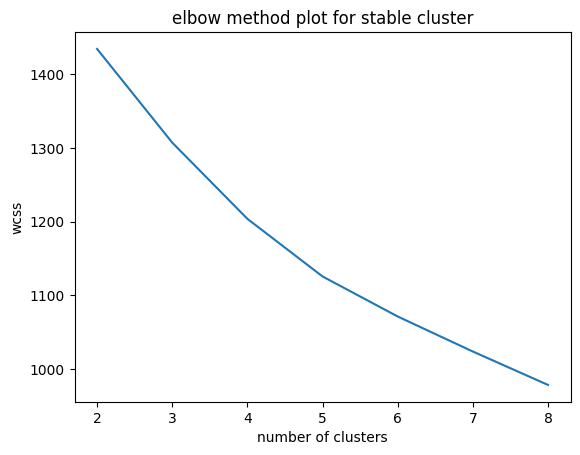

In [153]:
cluster_nums = [2,3,4,5,6,7,8]
x_values= []
y_values = []
for num in cluster_nums:
    wcss_best = 10000000
    for i in range(0,1000):
        kmeans = KMeans(num)
        kmeans.fit(df_stable[feelings])
        labels_test = kmeans.labels_
        cluster_centres = kmeans.cluster_centers_
        wcss = kmeans.inertia_
        if wcss< wcss_best:
            wcss_best = wcss
            labels_fin = labels_test
            cluster_centres_fin = cluster_centres
    x_values.append(num)
    y_values.append(wcss_best)
plt.plot(x_values,y_values)
plt.title('elbow method plot for stable cluster')
plt.xlabel('number of clusters')
plt.ylabel('wcss')
plt.savefig("C:/Users/hugma/diss/data/elbow_method_plot_for_stable_cluster")

In [154]:
downsampled_groups = []
for (subject, week, session), group in df_csv_file_original.groupby(['Subject', 'Week', 'Session']):
    downsampled = group.iloc[::no_of_jumps].copy()
    downsampled = downsampled[:-1]
    downsampled['Original_Index'] = downsampled.index
    downsampled_groups.append(downsampled)

# Concatenate downsampled groups into a DataFrame
df_downsampled = pd.concat(downsampled_groups)
df_downsampled['Cluster_Label'] = differences_array['clust']
df_csv_file_original['Cluster_Label'] = np.nan
for _, row in df_downsampled.iterrows():
    original_index = row['Original_Index']
    label = row['Cluster_Label']
    # Find the group of the original index
    group_info = df_csv_file_original.loc[original_index, ['Subject', 'Week', 'Session']]
    group_mask = (df_csv_file_original['Subject'] == group_info['Subject']) & \
                (df_csv_file_original['Week'] == group_info['Week']) & \
                (df_csv_file_original['Session'] == group_info['Session'])
    group_indices = df_csv_file_original[group_mask].index
    # Find the position of the original index within its group
    pos_in_group = list(group_indices).index(original_index)
    # Calculate the start and end indices to assign labels within the group based on no_of_jumps
    start_idx = pos_in_group - (pos_in_group % no_of_jumps)
    end_idx = min(start_idx + no_of_jumps, len(group_indices))
    for i in range(start_idx, end_idx):
        df_csv_file_original.at[group_indices[i], 'Cluster_Label'] = label

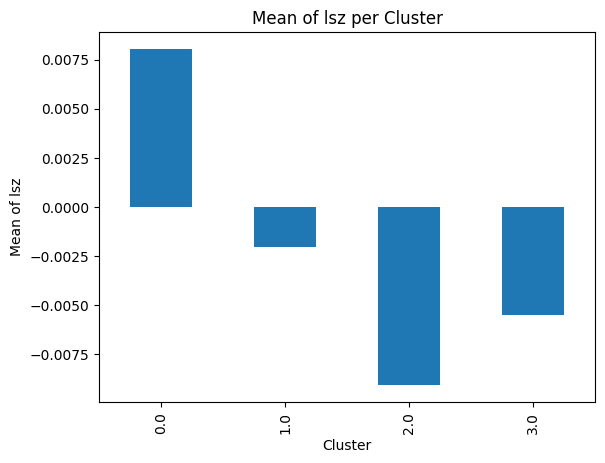

In [155]:
mean_lsz = df_csv_file_original['global_lzc'].mean()
mean_lsz_per_clust = df_csv_file_original.groupby('Cluster_Label')['global_lzc'].mean()-mean_lsz

# Now, plot the mean values as a bar graph
mean_lsz_per_clust.plot(kind='bar')
plt.xlabel('Cluster')
plt.ylabel('Mean of lsz')
plt.title('Mean of lsz per Cluster')
plt.show()